In [3]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import random
import math
import os
import cv2 as cv

**Data Gathering and Preprocessing**

In [4]:
#LOAD DATA
DIR = "D:/Temp/Kuliah/Skripsi/Coding/main/WasteDataset"
train_dataset = tf.keras.preprocessing.image_dataset_from_directory(DIR, validation_split=0.1, subset="training", seed=42, batch_size=128, smart_resize=True, image_size=(256, 256))
test_dataset = tf.keras.preprocessing.image_dataset_from_directory(DIR, validation_split=0.1, subset="validation", seed=42, batch_size=128, smart_resize=True, image_size=(256, 256))

classes = train_dataset.class_names
numClasses = len(train_dataset.class_names)
print(classes)

AUTOTUNE = tf.data.AUTOTUNE

train_dataset = train_dataset.prefetch(buffer_size=AUTOTUNE)
test_dataset = test_dataset.prefetch(buffer_size=AUTOTUNE)

Found 9000 files belonging to 6 classes.
Using 8100 files for training.
Found 9000 files belonging to 6 classes.
Using 900 files for validation.
['Glass', 'Metal', 'Organic', 'Paper', 'Plastic', 'Textile']


**Model Training**

In [5]:
baseModel = tf.keras.applications.MobileNetV3Large(input_shape=(256, 256,3), weights='imagenet', include_top=False, classes=numClasses)
for layers in baseModel.layers[:-6]:
  layers.trainable=False

last_output = baseModel.layers[-1].output
x = tf.keras.layers.Dropout(0.45) (last_output)
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.BatchNormalization() (x)
x = tf.keras.layers.Dense(256, activation = tf.keras.activations.elu, kernel_regularizer=tf.keras.regularizers.l1(0.045), activity_regularizer=tf.keras.regularizers.l1(0.045),  kernel_initializer='he_normal')(x)
x = tf.keras.layers.Dropout(0.45) (x)
x = tf.keras.layers.Dense(numClasses, activation='softmax')(x)

model = tf.keras.Model(inputs=baseModel.input,outputs=x)
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.00125), loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), metrics=['accuracy'])

epochs = 50
lrCallback = tf.keras.callbacks.LearningRateScheduler(lambda epoch: 1e-3 * 10 ** (epoch / 30))
stepDecay = tf.keras.callbacks.LearningRateScheduler(lambda epoch: 0.1 * 0.1**math.floor(epoch / 6))
history = model.fit(train_dataset, validation_data=test_dataset, epochs=epochs, callbacks=[])

Epoch 1/50


C:\Users\ASUS\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\backend.py:5585: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Softmax activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(


64/64 [==============================] - 566s 9s/step - loss: 161.0615 - accuracy: 0.7332 - val_loss: 18.9583 - val_accuracy: 0.8433
Epoch 2/50
64/64 [==============================] - 1005s 15s/step - loss: 6.5134 - accuracy: 0.8333 - val_loss: 3.7767 - val_accuracy: 0.7422
Epoch 3/50
64/64 [==============================] - 947s 15s/step - loss: 3.6856 - accuracy: 0.8225 - val_loss: 3.6774 - val_accuracy: 0.8289
Epoch 4/50
64/64 [==============================] - 1031s 16s/step - loss: 3.6131 - accuracy: 0.8325 - val_loss: 3.5614 - val_accuracy: 0.8178
Epoch 5/50
64/64 [==============================] - 992s 15s/step - loss: 3.4812 - accuracy: 0.8391 - val_loss: 3.3670 - val_accuracy: 0.8178
Epoch 6/50
64/64 [==============================] - 1010s 16s/step - loss: 3.3352 - accuracy: 0.8493 - val_loss: 3.2180 - val_accuracy: 0.8156
Epoch 7/50
64/64 [==============================] - 1029s 16s/step - loss: 3.2231 - accuracy: 0.8617 - val_loss: 3.1208 - val_accuracy: 0.8256
Epoch 8/50


In [6]:
model.save("D:/Temp/Kuliah/Skripsi/Coding/main/model.h5")
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling (Rescaling)          (None, 256, 256, 3)  0           ['input_1[0][0]']                
                                                                                                  
 Conv (Conv2D)                  (None, 128, 128, 16  432         ['rescaling[0][0]']              
                                )                                                                 
                                                                                              

**Model Evaluation**

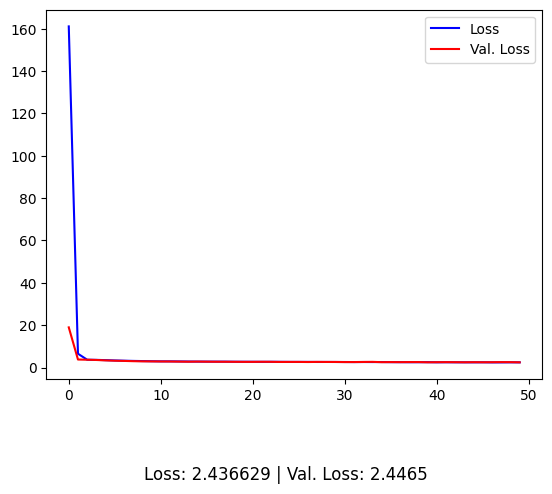

In [21]:
plt.plot(range(0, epochs), history.history["loss"], color="b", label="Loss")
plt.plot(range(0, epochs), history.history["val_loss"], color="r", label="Val. Loss")

last_loss = history.history["loss"][-1]
last_val_loss = history.history["val_loss"][-1]

plt.figtext(0.5, -0.1, f'Loss: {last_loss:.6f} | Val. Loss: {last_val_loss:.4f}', ha='center', fontsize=12, color='black')

plt.legend()
plt.show()

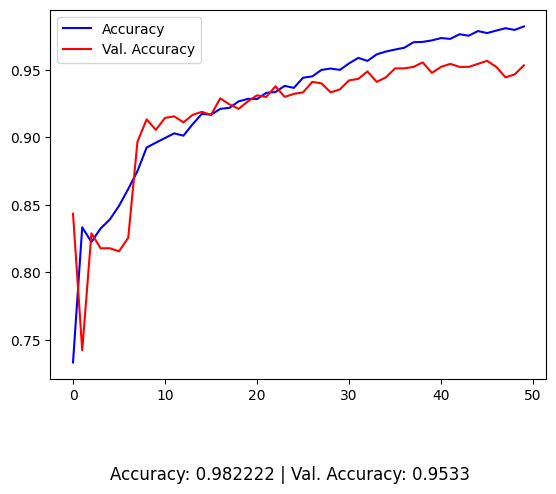

In [22]:
plt.plot(range(0, epochs), history.history["accuracy"], color="b", label="Accuracy")
plt.plot(range(0, epochs), history.history["val_accuracy"], color="r", label="Val. Accuracy")

last_acc = history.history["accuracy"][-1]
last_val_acc = history.history["val_accuracy"][-1]

plt.figtext(0.5, -0.1, f'Accuracy: {last_acc:.6f} | Val. Accuracy: {last_val_acc:.4f}', ha='center', fontsize=12, color='black')

plt.legend()
plt.show()

Text(0, 0.5, 'Loss')

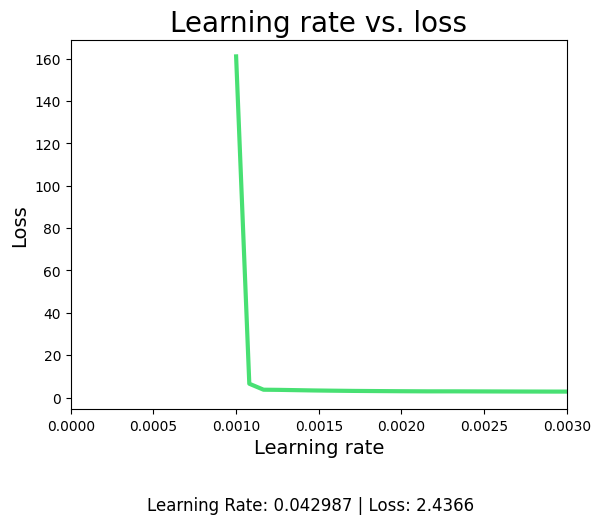

In [23]:
plt.xlim([0, 0.003])
learning_rates = 1e-3 * (10 ** (np.arange(epochs) / 30))
plt.plot(learning_rates, history.history['loss'], lw=3, color='#48e073')

last_lr = learning_rates[-1]
last_loss = history.history['loss'][-1]

plt.figtext(0.5, -0.1, f'Learning Rate: {last_lr:.6f} | Loss: {last_loss:.4f}', ha='center', fontsize=12, color='black')

plt.title('Learning rate vs. loss', size=20)
plt.xlabel('Learning rate', size=14)
plt.ylabel('Loss', size=14)

**Confusion Matrix**

1/1 [==============================] - 0s 63ms/step


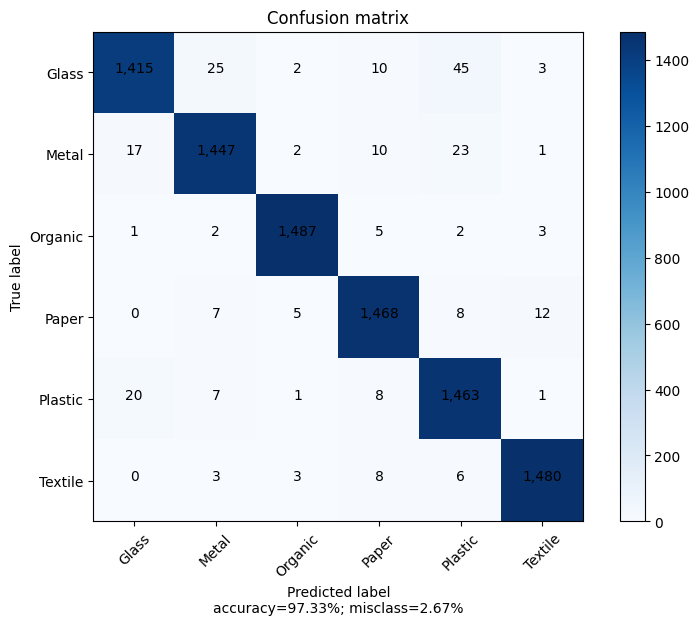

Misclassified Images for Class: Glass


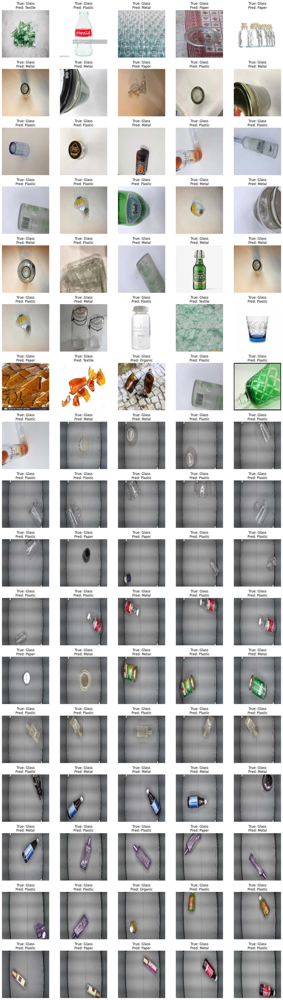

Misclassified Images for Class: Metal


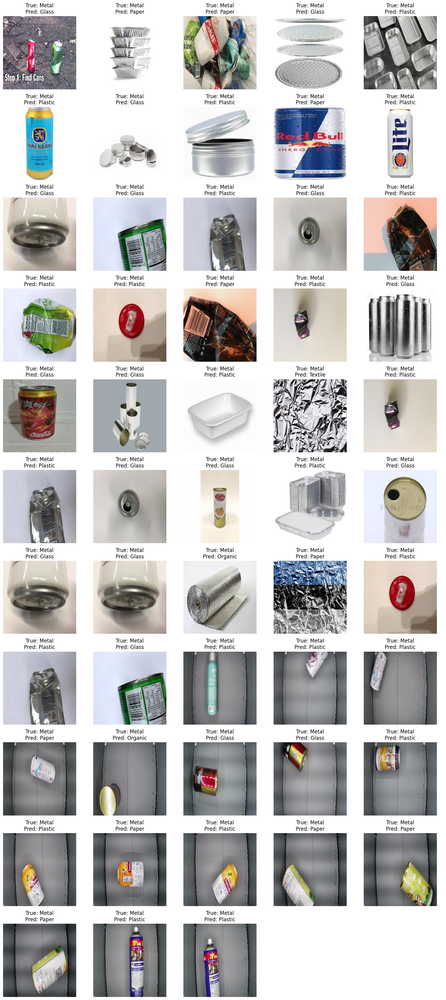

Misclassified Images for Class: Organic


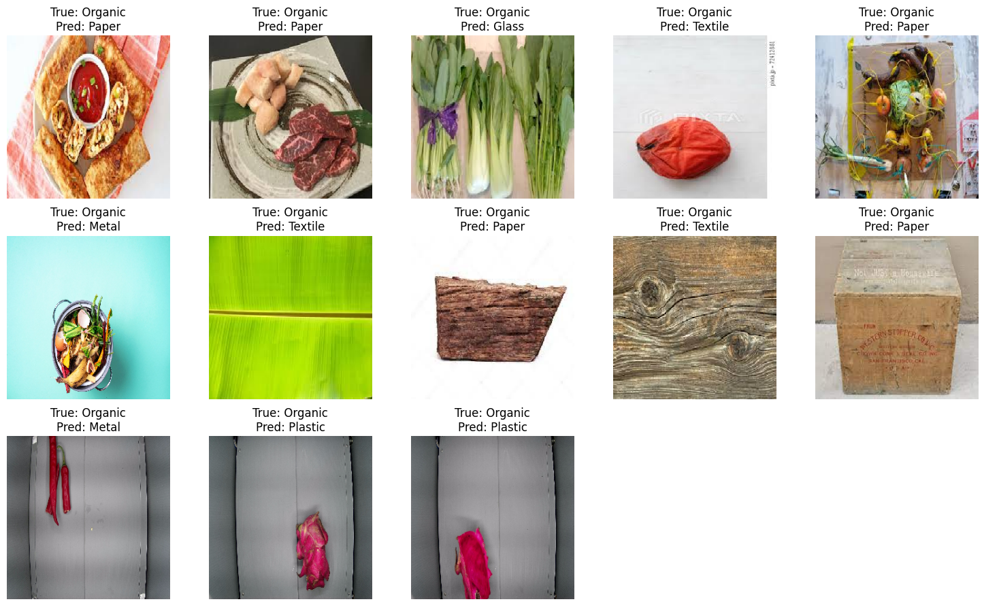

Misclassified Images for Class: Paper


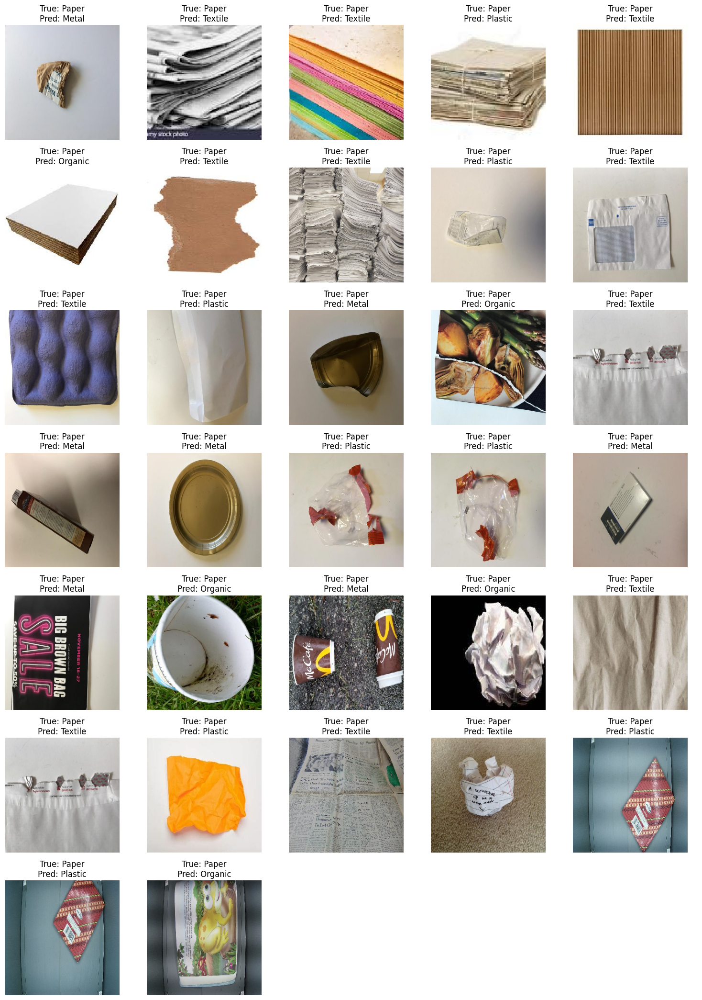

Misclassified Images for Class: Plastic


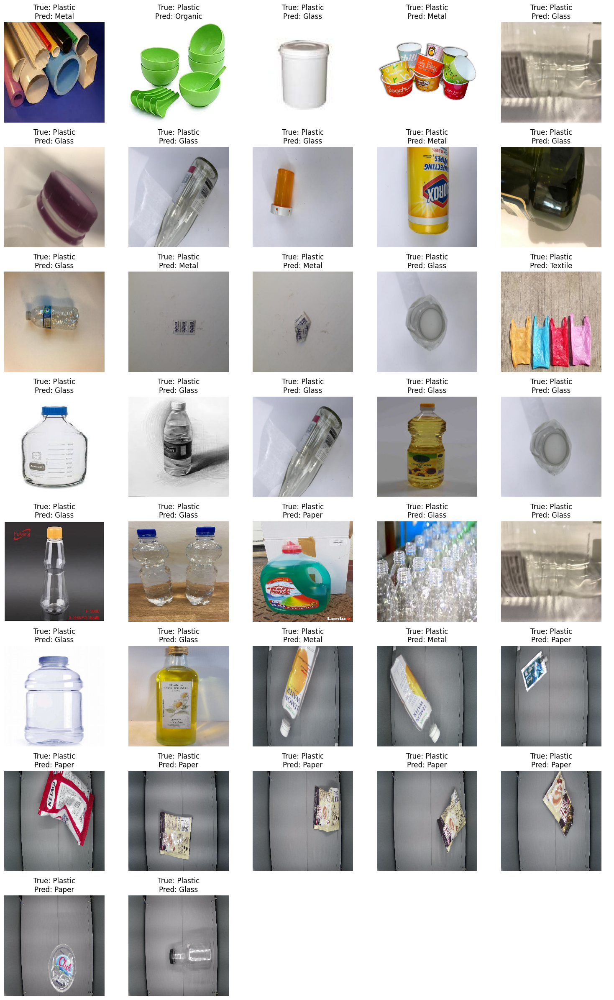

Misclassified Images for Class: Textile


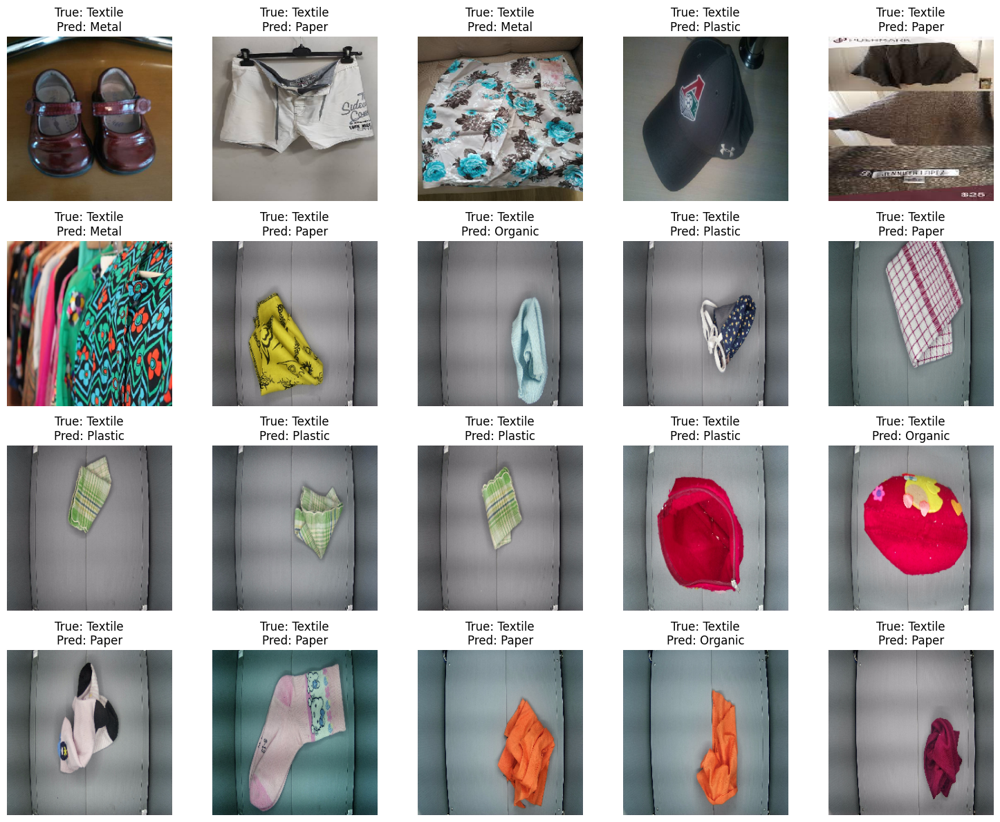

In [11]:
import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from itertools import product

def plot_confusion_matrix(cm, target_names, cmap=None):
    accuracy = np.trace(cm) / float(np.sum(cm))
    misclass = 1 - accuracy

    if cmap is None:
        cmap = plt.get_cmap('Blues')

    plt.figure(figsize=(8, 6))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title('Confusion matrix')
    plt.colorbar()

    if target_names is not None:
        tick_marks = np.arange(len(target_names))
        plt.xticks(tick_marks, target_names, rotation=45)
        plt.yticks(tick_marks, target_names)

    for i, j in product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, f"{cm[i, j]:,}",
                 horizontalalignment="center",
                 color="black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel(f'Predicted label\naccuracy={accuracy * 100:.2f}%; misclass={misclass * 100:.2f}%')
    plt.show()

def show_misclassified_images(misclassified, classes):
    """
    Display misclassified images along with true and predicted labels.
    
    Parameters:
    - misclassified: List of tuples [(image, true_label, predicted_label), ...]
    - classes: List of class names
    """
    for true_label in range(len(classes)):
        images = [entry for entry in misclassified if entry[1] == true_label]

        if images:
            print(f"Misclassified Images for Class: {classes[true_label]}")
            num_images = len(images)
            cols = 5
            rows = (num_images // cols) + (num_images % cols > 0)

            fig, axes = plt.subplots(rows, cols, figsize=(15, 3 * rows))
            axes = axes.flatten()
            for ax, (img, true, pred) in zip(axes, images):
                ax.imshow(img.numpy().astype('uint8'))
                ax.axis('off')
                ax.set_title(f"True: {classes[true]}\nPred: {classes[pred]}")

            # Hide any unused subplots
            for ax in axes[len(images):]:
                ax.axis('off')

            plt.tight_layout()
            plt.show()

# Initialize variables
true = []
predictions = []
misclassified_images = []

# Define dataset path and classes
path = "D:/Temp/Kuliah/Skripsi/Coding/main/WasteDataset"
classes = sorted(os.listdir(path))  # Assuming folder names represent class names

# Process images
for class_idx, class_name in enumerate(classes):
    folderPath = os.path.join(path, class_name)
    for img_name in os.listdir(folderPath):
        fullPath = os.path.join(folderPath, img_name)
        try:
            # Load and preprocess image
            img = tf.keras.preprocessing.image.load_img(fullPath, target_size=(256, 256))
            img_array = tf.keras.preprocessing.image.img_to_array(img)
            img_array = tf.expand_dims(img_array, 0)

            # Predict with model
            preds = model.predict(img_array)
            true_label = class_idx
            predicted_label = np.argmax(preds)

            # Append to results
            true.append(true_label)
            predictions.append(predicted_label)

            # Save misclassified images
            if true_label != predicted_label:
                misclassified_images.append((img_array[0], true_label, predicted_label))
        except Exception as e:
            print(f"Error on image {fullPath}: {e}")

# Generate confusion matrix
conf_matrix = tf.math.confusion_matrix(true, predictions).numpy()
plot_confusion_matrix(conf_matrix, classes)

# Display misclassified images
show_misclassified_images(misclassified_images, classes)

1/1 [==============================] - 0s 78ms/step


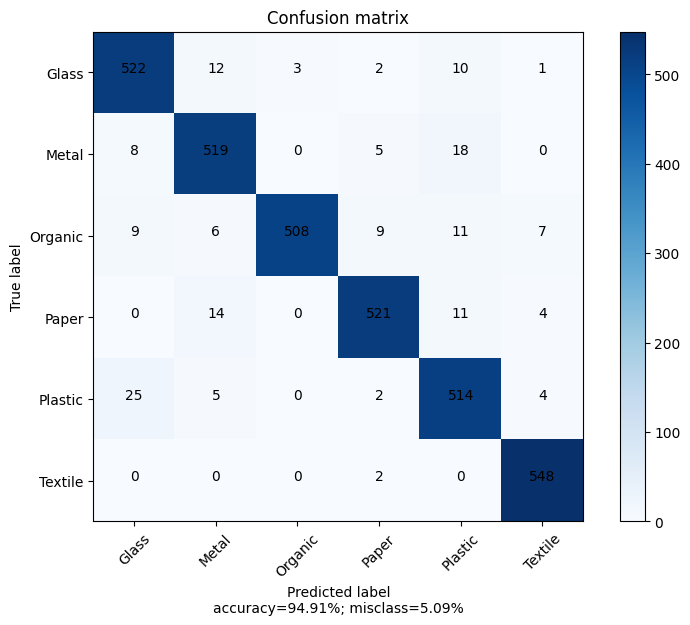

Misclassified Images for Class: Glass


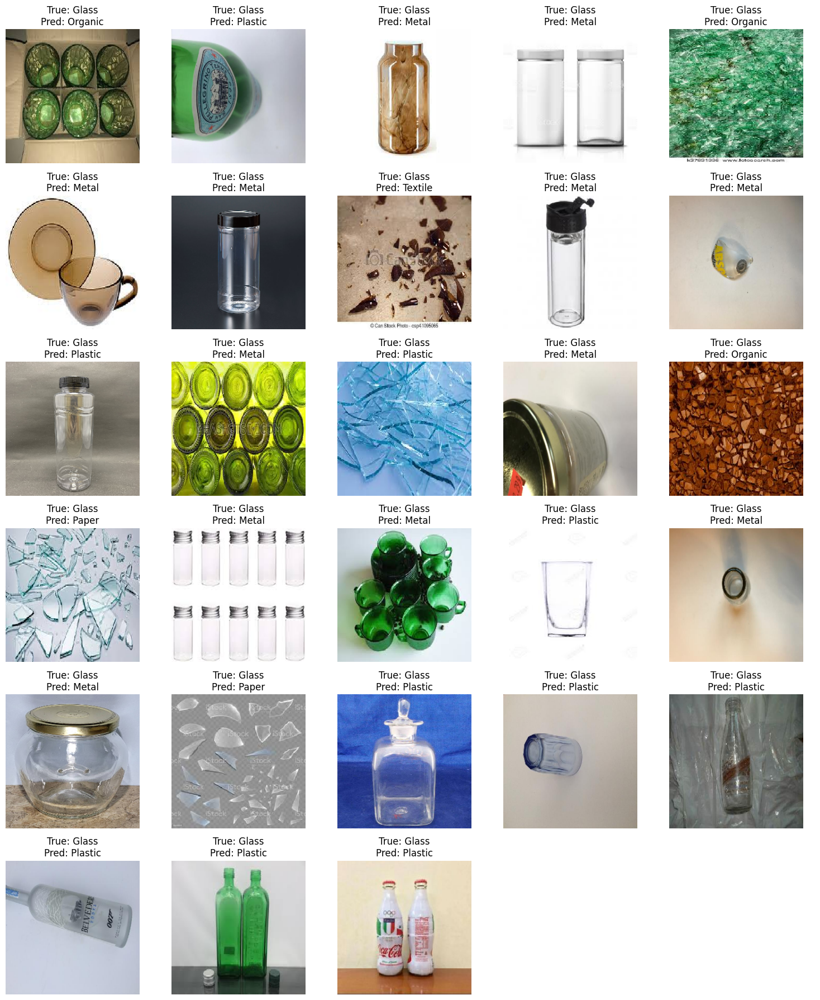

Misclassified Images for Class: Metal


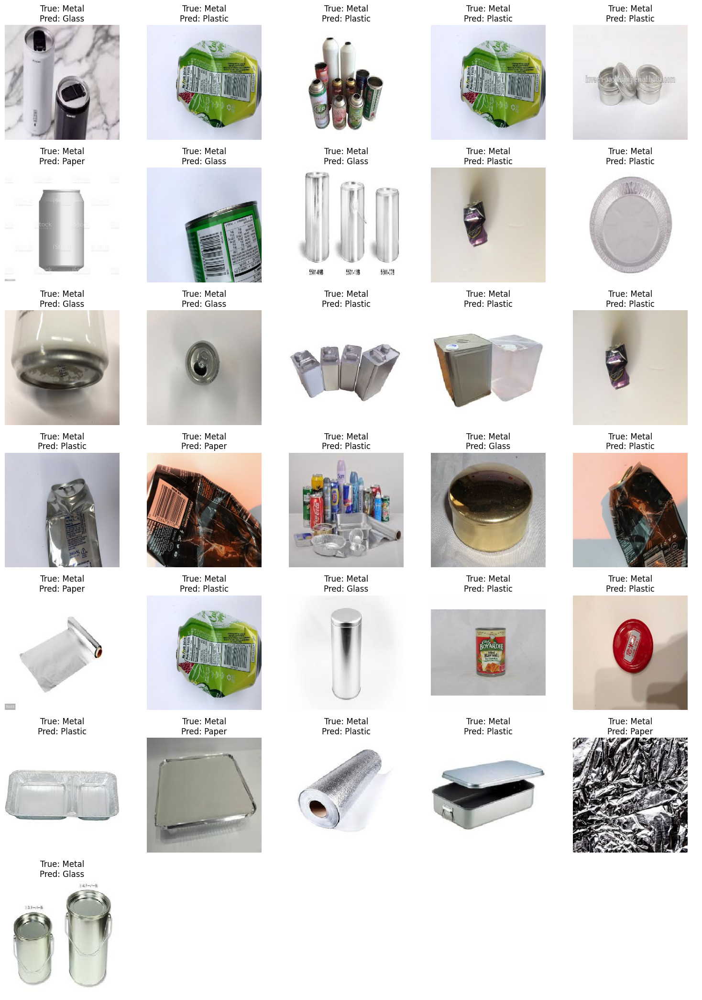

Misclassified Images for Class: Organic


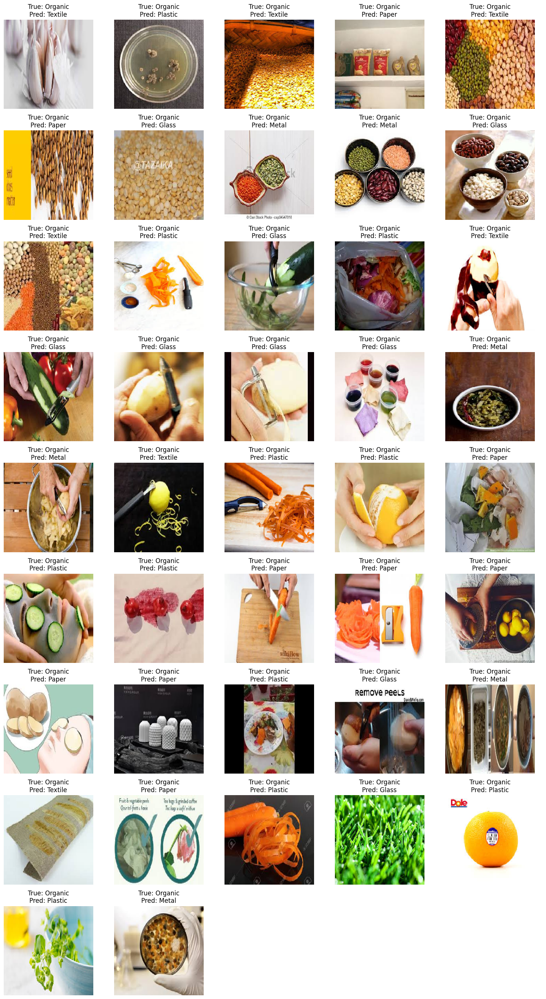

Misclassified Images for Class: Paper


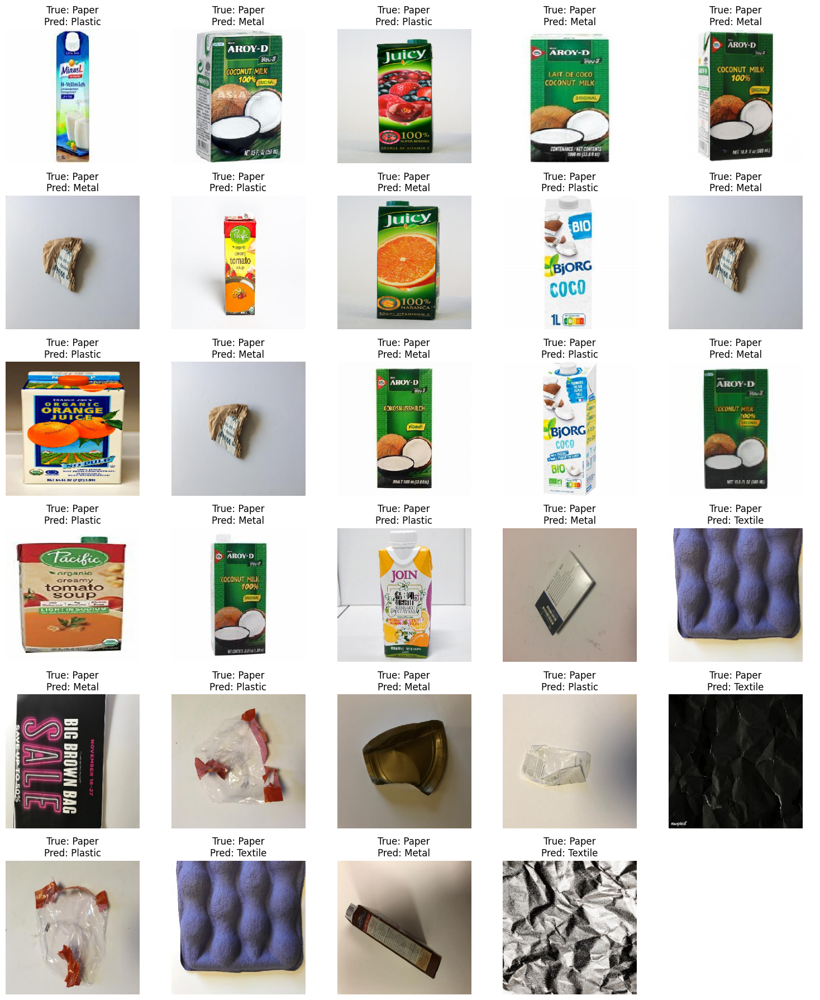

Misclassified Images for Class: Plastic


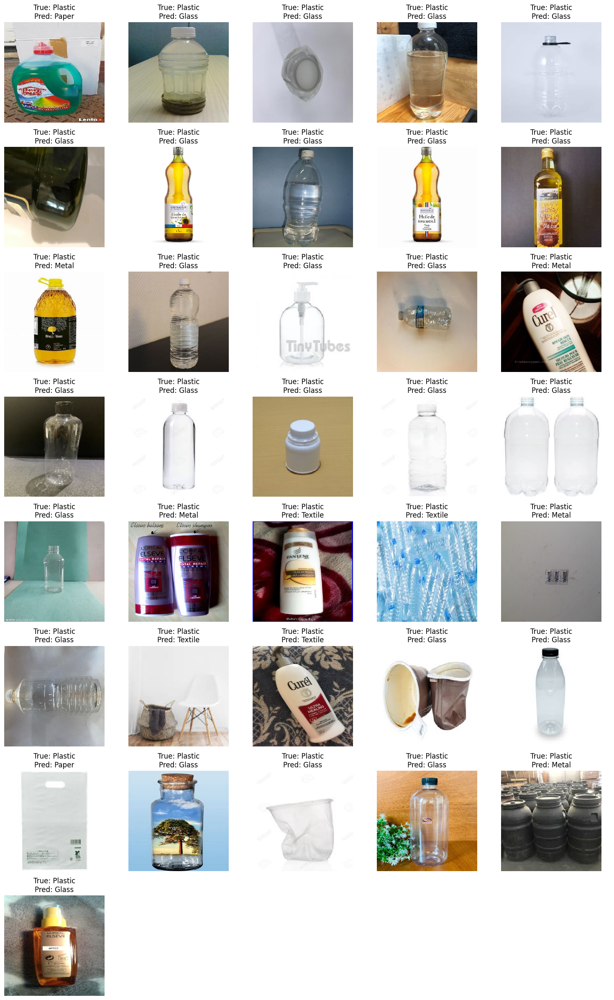

Misclassified Images for Class: Textile


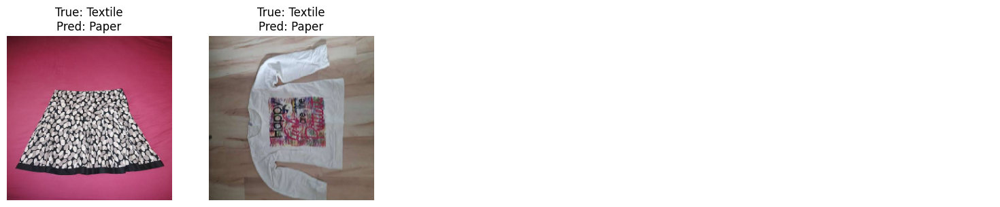

In [12]:
import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from itertools import product

def plot_confusion_matrix(cm, target_names, cmap=None):
    accuracy = np.trace(cm) / float(np.sum(cm))
    misclass = 1 - accuracy

    if cmap is None:
        cmap = plt.get_cmap('Blues')

    plt.figure(figsize=(8, 6))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title('Confusion matrix')
    plt.colorbar()

    if target_names is not None:
        tick_marks = np.arange(len(target_names))
        plt.xticks(tick_marks, target_names, rotation=45)
        plt.yticks(tick_marks, target_names)

    for i, j in product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, f"{cm[i, j]:,}",
                 horizontalalignment="center",
                 color="black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel(f'Predicted label\naccuracy={accuracy * 100:.2f}%; misclass={misclass * 100:.2f}%')
    plt.show()

def show_misclassified_images(misclassified, classes):
    """
    Display misclassified images along with true and predicted labels.
    
    Parameters:
    - misclassified: List of tuples [(image, true_label, predicted_label), ...]
    - classes: List of class names
    """
    for true_label in range(len(classes)):
        images = [entry for entry in misclassified if entry[1] == true_label]

        if images:
            print(f"Misclassified Images for Class: {classes[true_label]}")
            num_images = len(images)
            cols = 5
            rows = (num_images // cols) + (num_images % cols > 0)

            fig, axes = plt.subplots(rows, cols, figsize=(15, 3 * rows))
            axes = axes.flatten()
            for ax, (img, true, pred) in zip(axes, images):
                ax.imshow(img.numpy().astype('uint8'))
                ax.axis('off')
                ax.set_title(f"True: {classes[true]}\nPred: {classes[pred]}")

            # Hide any unused subplots
            for ax in axes[len(images):]:
                ax.axis('off')

            plt.tight_layout()
            plt.show()

# Initialize variables
true = []
predictions = []
misclassified_images = []

# Define dataset path and classes
path = "D:/Temp/Kuliah/Skripsi/Coding/main/Data"
classes = sorted(os.listdir(path))  # Assuming folder names represent class names

# Process images
for class_idx, class_name in enumerate(classes):
    folderPath = os.path.join(path, class_name)
    for img_name in os.listdir(folderPath):
        fullPath = os.path.join(folderPath, img_name)
        try:
            # Load and preprocess image
            img = tf.keras.preprocessing.image.load_img(fullPath, target_size=(256, 256))
            img_array = tf.keras.preprocessing.image.img_to_array(img)
            img_array = tf.expand_dims(img_array, 0)

            # Predict with model
            preds = model.predict(img_array)
            true_label = class_idx
            predicted_label = np.argmax(preds)

            # Append to results
            true.append(true_label)
            predictions.append(predicted_label)

            # Save misclassified images
            if true_label != predicted_label:
                misclassified_images.append((img_array[0], true_label, predicted_label))
        except Exception as e:
            print(f"Error on image {fullPath}: {e}")

# Generate confusion matrix
conf_matrix = tf.math.confusion_matrix(true, predictions).numpy()
plot_confusion_matrix(conf_matrix, classes)

# Display misclassified images
show_misclassified_images(misclassified_images, classes)

1/1 [==============================] - 0s 76ms/step


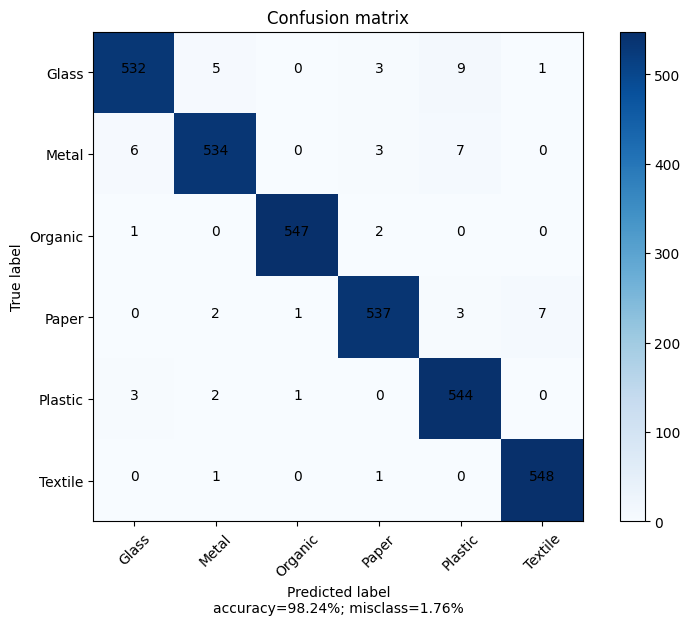

Misclassified Images for Class: Glass


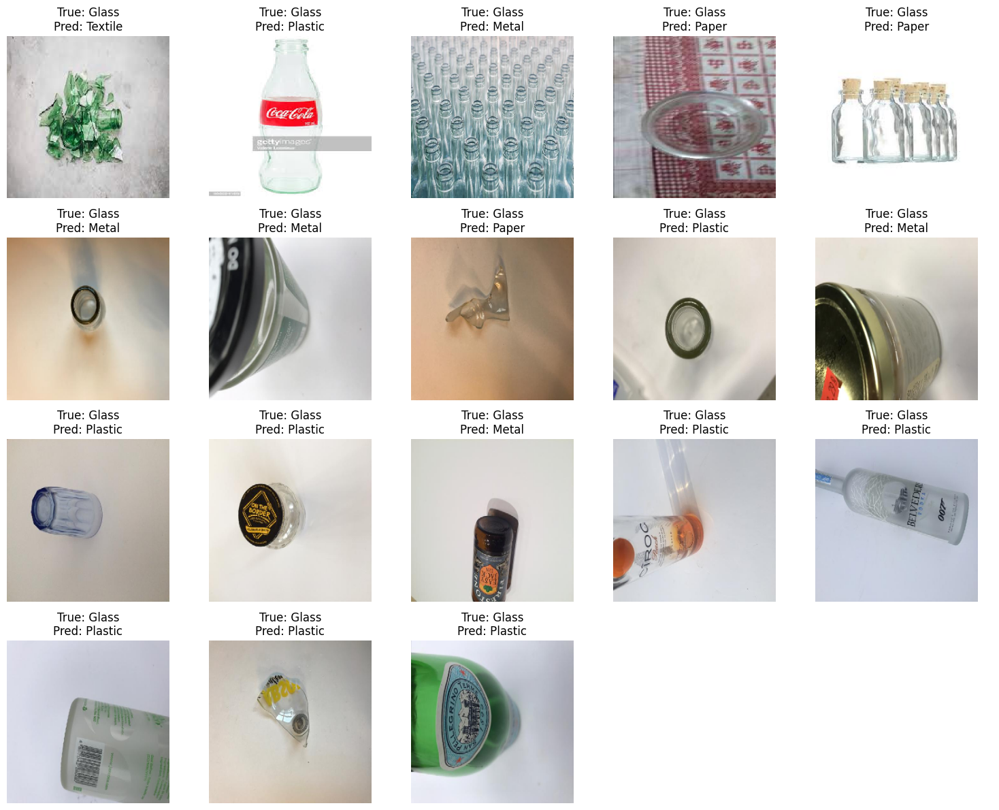

Misclassified Images for Class: Metal


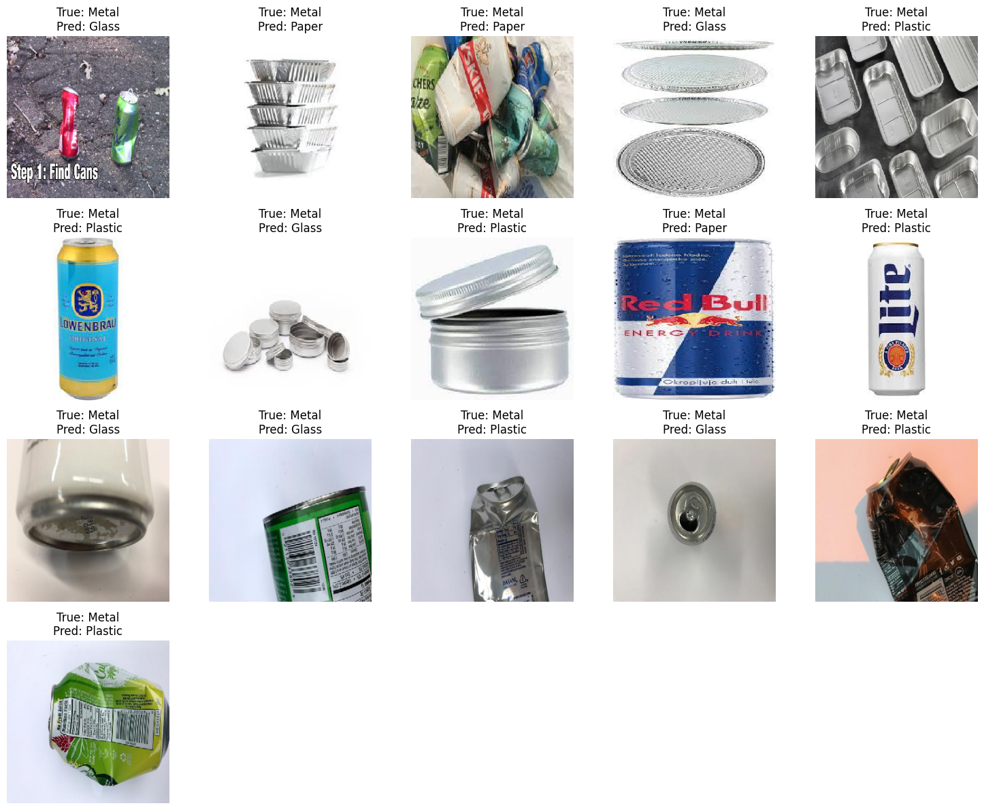

Misclassified Images for Class: Organic


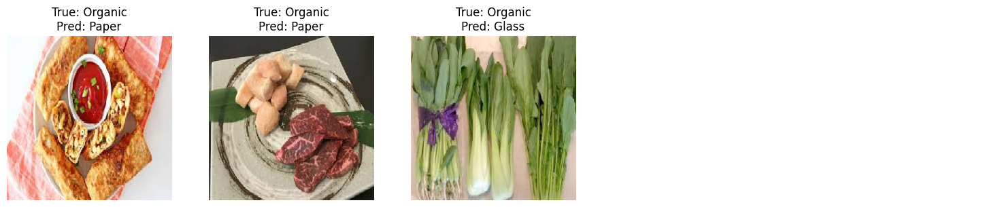

Misclassified Images for Class: Paper


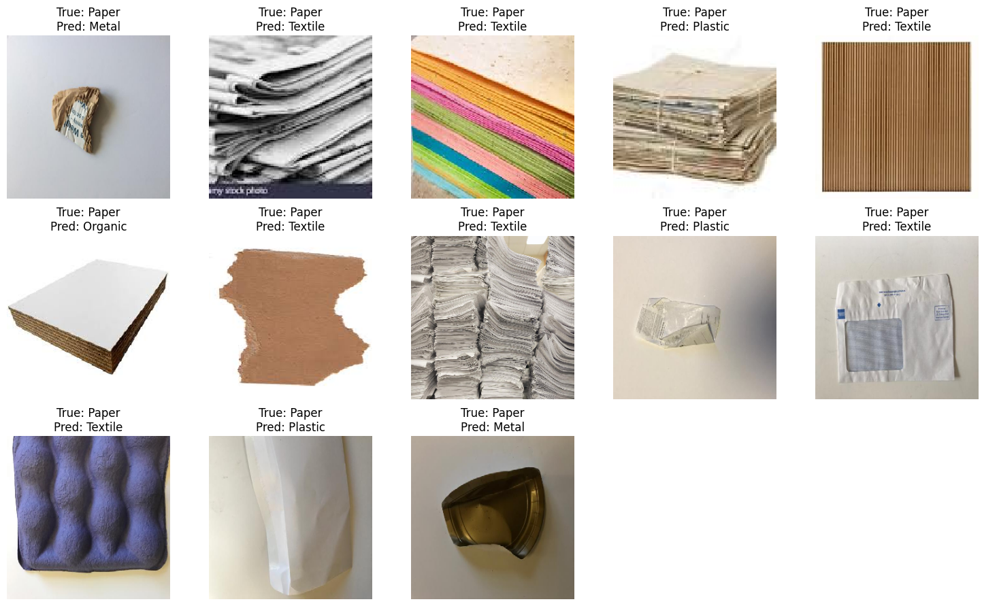

Misclassified Images for Class: Plastic


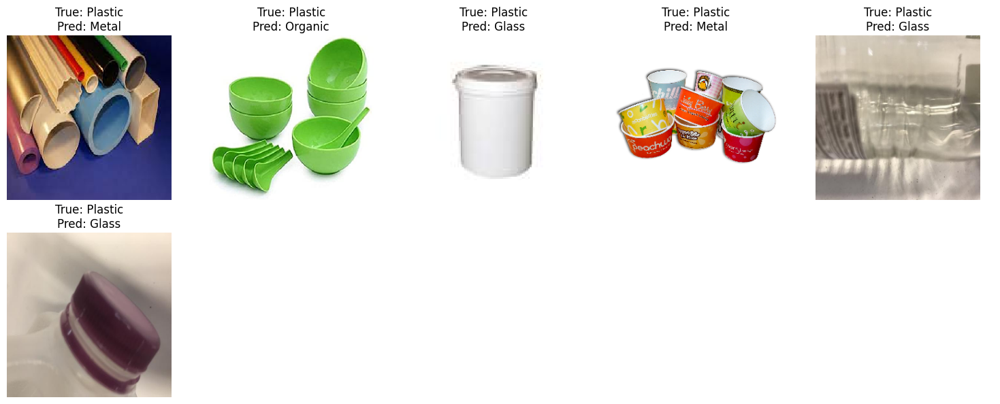

Misclassified Images for Class: Textile


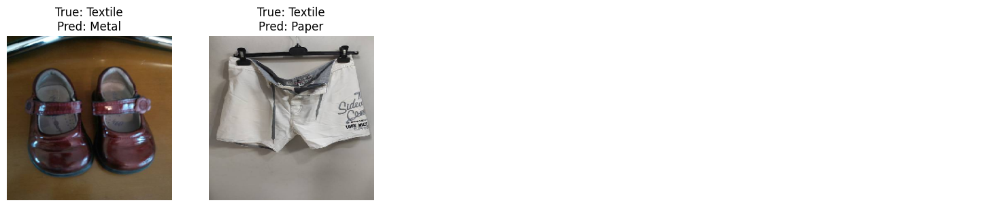

In [24]:
import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from itertools import product

def plot_confusion_matrix(cm, target_names, cmap=None):
    accuracy = np.trace(cm) / float(np.sum(cm))
    misclass = 1 - accuracy

    if cmap is None:
        cmap = plt.get_cmap('Blues')

    plt.figure(figsize=(8, 6))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title('Confusion matrix')
    plt.colorbar()

    if target_names is not None:
        tick_marks = np.arange(len(target_names))
        plt.xticks(tick_marks, target_names, rotation=45)
        plt.yticks(tick_marks, target_names)

    for i, j in product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, f"{cm[i, j]:,}",
                 horizontalalignment="center",
                 color="black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel(f'Predicted label\naccuracy={accuracy * 100:.2f}%; misclass={misclass * 100:.2f}%')
    plt.show()

def show_misclassified_images(misclassified, classes):
    """
    Display misclassified images along with true and predicted labels.
    
    Parameters:
    - misclassified: List of tuples [(image, true_label, predicted_label), ...]
    - classes: List of class names
    """
    for true_label in range(len(classes)):
        images = [entry for entry in misclassified if entry[1] == true_label]

        if images:
            print(f"Misclassified Images for Class: {classes[true_label]}")
            num_images = len(images)
            cols = 5
            rows = (num_images // cols) + (num_images % cols > 0)

            fig, axes = plt.subplots(rows, cols, figsize=(15, 3 * rows))
            axes = axes.flatten()
            for ax, (img, true, pred) in zip(axes, images):
                ax.imshow(img.numpy().astype('uint8'))
                ax.axis('off')
                ax.set_title(f"True: {classes[true]}\nPred: {classes[pred]}")

            # Hide any unused subplots
            for ax in axes[len(images):]:
                ax.axis('off')

            plt.tight_layout()
            plt.show()

# Initialize variables
true = []
predictions = []
misclassified_images = []

# Define dataset path and classes
path = "D:/Temp/Kuliah/Skripsi/Coding/main/WasteDataset"
classes = sorted(os.listdir(path))  # Assuming folder names represent class names

# Process images
for class_idx, class_name in enumerate(classes):
    folderPath = os.path.join(path, class_name)
    for img_name in os.listdir(folderPath)[:550]:
        fullPath = os.path.join(folderPath, img_name)
        try:
            # Load and preprocess image
            img = tf.keras.preprocessing.image.load_img(fullPath, target_size=(256, 256))
            img_array = tf.keras.preprocessing.image.img_to_array(img)
            img_array = tf.expand_dims(img_array, 0)

            # Predict with model
            preds = model.predict(img_array)
            true_label = class_idx
            predicted_label = np.argmax(preds)

            # Append to results
            true.append(true_label)
            predictions.append(predicted_label)

            # Save misclassified images
            if true_label != predicted_label:
                misclassified_images.append((img_array[0], true_label, predicted_label))
        except Exception as e:
            print(f"Error on image {fullPath}: {e}")

# Generate confusion matrix
conf_matrix = tf.math.confusion_matrix(true, predictions).numpy()
plot_confusion_matrix(conf_matrix, classes)

# Display misclassified images
show_misclassified_images(misclassified_images, classes)

**Testing**

In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import random
import math
import os
import cv2
from tensorflow.keras.models import load_model

In [298]:

path = "D:/Temp/Kuliah/Skripsi/Coding/Camera Test/30.jpg"

img = tf.keras.preprocessing.image.load_img(path, target_size=(256, 256))
img_array = tf.keras.preprocessing.image.img_to_array(img)
img_array = np.rot90(img_array, 2)
img_array = tf.expand_dims(img_array, 0)
# img_array = img_array/255.0


1/1 [==============================] - 2s 2s/step
[ 0.1353612   0.17288533  0.07693691 30.31336     0.13459334 69.16686   ] 
 ['Glass', 'Metal', 'Organic', 'Paper', 'Plastic', 'Textile']
Prediction:  Textile 69.16686296463013%


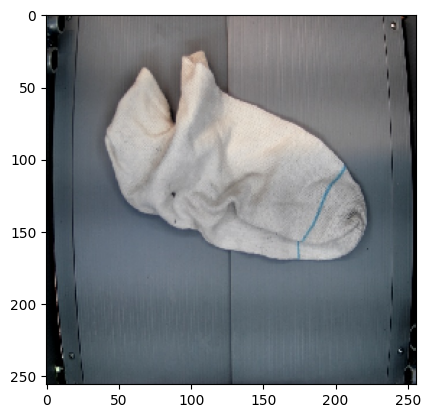

In [299]:
loaded_model = load_model("D:/Temp/Kuliah/Skripsi/Coding/main/model.h5")

classes = ["Glass", "Metal", "Organic", "Paper", "Plastic", "Textile"]

predictions = loaded_model.predict(img_array)

plt.imshow(img)
print(predictions[0]*100, "\n", classes)
print("Prediction: ", classes[np.argmax(predictions)], f"{predictions[0][np.argmax(predictions)]*100}%")

**Advanced Filter Visualization**

1/1 [==============================] - 0s 122ms/step


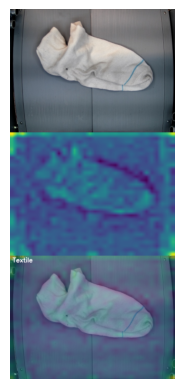

In [300]:
from tensorflow.keras.models import Model
import tensorflow as tf
import numpy as np
import cv2
import imutils

class GradCAM:
  def __init__(self, model, classIdx, layerName=None):
    self.model = model
    self.classIdx = classIdx
    self.layerName = layerName
    if self.layerName is None:
      self.layerName = self.find_target_layer()

  def find_target_layer(self):
    for layer in reversed(self.model.layers):
      if len(layer.output_shape) == 4:
        return layer.name
    raise ValueError("Could not find 4D layer. Cannot apply GradCAM.")

  def compute_heatmap(self, image, eps=1e-8):
    gradModel = Model(
			inputs=[self.model.inputs],
			outputs=[self.model.get_layer(self.layerName).output,
				self.model.output])
    with tf.GradientTape() as tape:
      inputs = tf.cast(image, tf.float32)
      (convOutputs, predictions) = gradModel(inputs)
      loss = predictions[:, self.classIdx]
    grads = tape.gradient(loss, convOutputs)
    castConvOutputs = tf.cast(convOutputs > 0, "float32")
    castGrads = tf.cast(grads > 0, "float32")
    guidedGrads = castConvOutputs * castGrads * grads
    convOutputs = convOutputs[0]
    guidedGrads = guidedGrads[0]
    weights = tf.reduce_mean(guidedGrads, axis=(0, 1))
    cam = tf.reduce_sum(tf.multiply(weights, convOutputs), axis=-1)
    (w, h) = (image.shape[2], image.shape[1])
    heatmap = cv2.resize(cam.numpy(), (w, h))
    numer = heatmap - np.min(heatmap)
    denom = (heatmap.max() - heatmap.min()) + eps
    heatmap = numer / denom
    heatmap = (heatmap * 255).astype("uint8")
    return heatmap

  def overlay_heatmap(self, heatmap, image, alpha=0.5, colormap=cv2.COLORMAP_VIRIDIS):
    heatmap = cv2.applyColorMap(heatmap, colormap)
    output = cv2.addWeighted(image, alpha, heatmap, 1 - alpha, 0)
    return (heatmap, output)

#path = "C:/Users/ASUS/OneDrive/Dokumen/Temp/Kuliah/Skripsi/Coding/main/Sample/sample9.jpeg
orig = cv2.imread(path)
resized = cv2.resize(orig, (256, 256))

image = tf.keras.preprocessing.image.load_img(path, target_size=(256, 256))
image = tf.keras.preprocessing.image.img_to_array(image)
image = np.expand_dims(image, axis=0)

predictions = loaded_model.predict(image)
cam = GradCAM(loaded_model, np.argmax(predictions[0]), "expanded_conv_6/expand")
heatmap = cv2.resize(cam.compute_heatmap(image), (orig.shape[1], orig.shape[0]))

#heatmap = cv2.resize(heatmap, (orig.shape[1], orig.shape[0]))
(heatmap, output) = cam.overlay_heatmap(heatmap, orig, alpha=0.5)

#cv2.rectangle(output, (0, 0), (340, 40), (0, 0, 0), -1)
cv2.putText(output, classes[np.argmax(predictions)], (10, 25), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 255, 255), 2)

output = np.vstack([orig, heatmap, output])
output = imutils.resize(output, height=700)

output_rgb = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)

plt.imshow(output_rgb)
plt.axis('off')
plt.show()

**Pre-processing**

In [301]:
"""
# Load the image
path = "C:/Users/ASUS/OneDrive/Dokumen/Temp/Kuliah/Skripsi/Coding/Camera Test/photos/33.jpg"
image = cv2.imread(path)  # Image is loaded in BGR format by default

# Convert the image to grayscale for edge detection
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply edge detection
edges = cv2.Canny(gray, 50, 150)

# Find contours in the edge-detected image
contours, _ = cv2.findContours(edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

# Find the largest contour which is likely the box
contour = max(contours, key=cv2.contourArea)

# Get bounding box for the largest contour
x, y, w, h = cv2.boundingRect(contour)

# Crop the image using the bounding box on the original image (BGR format)
cropped_image = image[y:y+h, x:x+w]

# Convert the cropped image from BGR to RGB
cropped_image_rgb = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB)

# Display the cropped image
plt.imshow(cropped_image_rgb)
plt.axis('off')
plt.show()

# Image to array
target_size = (256, 256)
img = tf.image.resize(cropped_image_rgb, target_size)
img_array = tf.keras.preprocessing.image.img_to_array(img)
img_array = np.rot90(img_array, 2)
img_array = tf.expand_dims(img_array, 0)
"""

'\n# Load the image\npath = "C:/Users/ASUS/OneDrive/Dokumen/Temp/Kuliah/Skripsi/Coding/Camera Test/photos/33.jpg"\nimage = cv2.imread(path)  # Image is loaded in BGR format by default\n\n# Convert the image to grayscale for edge detection\ngray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)\n\n# Apply edge detection\nedges = cv2.Canny(gray, 50, 150)\n\n# Find contours in the edge-detected image\ncontours, _ = cv2.findContours(edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)\n\n# Find the largest contour which is likely the box\ncontour = max(contours, key=cv2.contourArea)\n\n# Get bounding box for the largest contour\nx, y, w, h = cv2.boundingRect(contour)\n\n# Crop the image using the bounding box on the original image (BGR format)\ncropped_image = image[y:y+h, x:x+w]\n\n# Convert the cropped image from BGR to RGB\ncropped_image_rgb = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB)\n\n# Display the cropped image\nplt.imshow(cropped_image_rgb)\nplt.axis(\'off\')\nplt.show()\n\n# Image to array

In [302]:
"""
# Load the image using TensorFlow
path = "D:/Temp/Kuliah/Skripsi/Coding/Camera Test/photos/33.jpg"
image = tf.io.read_file(path)
image = tf.image.decode_jpeg(image)

# Assume that you know the coordinates of the bounding box
# Replace (x, y) and (w, h) with the actual values you want
x, y, w, h = 150, 100, 300, 300  # Example values

# Crop the image
cropped_image = tf.image.crop_to_bounding_box(image, y, x, h, w)

# Convert tensor to numpy array for visualization
cropped_image_np = cropped_image.numpy()

# Display the cropped image
plt.imshow(cropped_image_np)
plt.axis('off')
plt.show()

# Image to array
target_size = (256, 256)
img = tf.image.resize(cropped_image_np, target_size)
img_array = tf.keras.preprocessing.image.img_to_array(img)
img_array = np.rot90(img_array, 2)
img_array = tf.expand_dims(img_array, 0)
"""

'\n# Load the image using TensorFlow\npath = "D:/Temp/Kuliah/Skripsi/Coding/Camera Test/photos/33.jpg"\nimage = tf.io.read_file(path)\nimage = tf.image.decode_jpeg(image)\n\n# Assume that you know the coordinates of the bounding box\n# Replace (x, y) and (w, h) with the actual values you want\nx, y, w, h = 150, 100, 300, 300  # Example values\n\n# Crop the image\ncropped_image = tf.image.crop_to_bounding_box(image, y, x, h, w)\n\n# Convert tensor to numpy array for visualization\ncropped_image_np = cropped_image.numpy()\n\n# Display the cropped image\nplt.imshow(cropped_image_np)\nplt.axis(\'off\')\nplt.show()\n\n# Image to array\ntarget_size = (256, 256)\nimg = tf.image.resize(cropped_image_np, target_size)\nimg_array = tf.keras.preprocessing.image.img_to_array(img)\nimg_array = np.rot90(img_array, 2)\nimg_array = tf.expand_dims(img_array, 0)\n'